## Part 3: Data Preprocessing

### The main objective is to combine different files to make an annotation file in COCO mask file format

**The dataset files are built by `nuScene.org`, that seperated into multiple files**
1. `log` - Information about the log from which the data was extracted, use to identify the location of the car (Singapore or boston)
2. `sample` - A sample is an annotated keyframe selected from a large pool of images in a log. Every sample has up to 13 camera sample_datas corresponding to it. These include the keyframe, which can be accessed via key_camera_token. We use the data set to link `log` to `sample_data`.
3. `sample_data` - Sample_data contains the images and information about when they were captured. Sample_data covers all images, regardless of whether they are a keyframe or not. Only keyframes are annotated. From this set, we will get the important features like width and height, then further link to annotation files.
4. `surface_ann` - The annotation of a background object (driveable surface) in an image. We will create our own bbox from the MASK here.
5. `object_ann` - The annotation of a foreground object (car, bike, pedestrian) in an image. Each foreground object is annotated with a 2d box, a 2d instance mask and category-specific attributes.
6. `category` - Taxonomy of object categories. Both `surface_ann` and `object_ann` has to link to this file to get the categories' name. Expected to have 23 categories in the dataset :

The dats stucrures are as shown:

![Image](./assets/images/DataStructure.png)

---
   

In this notebook, the files will be combined into a single dataset which consist all the essential information in **COCO** format.
The methodology including cleaning, joining tables and sampling of data.

The COCO mask annotation file is expecting the key as following:

| Key | Description |
| --- | --- |
|file_name | image filename |
|image_id | any index to assign |
|height | image height |
|width | imgae width |
|bbox | 4 points bbox ([xmin,ymin,xmax,ymax])
|bbox_mode | XYXY_ABS |
|segmentation | poly format of segmentation[x1, y1, ..., xn, yn] |
|category_id | assigned mapped category Id |

---

In [1]:
# import the necessary packages

import numpy as np
import json
import pandas as pd
import matplotlib.pyplot as plt
import re
import json
from PIL import Image, ImageDraw
import os.path as osp

### 1. Log File Processing

In [2]:
# Log file 
# Please use the path where you have stored the log file 
with open('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/v1.0-train/log.json', 'rb') as f:
  log = json.load(f)
  log_df = pd.DataFrame(log)

In [3]:
print(log_df.shape)
log_df.head()

(350, 5)


,token,logfile,location,vehicle,date_captured
0,ddefc6e23b5147a4bb04f51ebcb8ddb1,n003-2018-01-03-12-03-23+0800,singapore-onenorth,n003,2018-01-03
1,8322bb4604ad409886bb655470941a22,n003-2018-01-03-14-16-47+0800,singapore-onenorth,n003,2018-01-03
2,d0e0f3306cf6413e82fc4b9ea1f1f00a,n003-2018-01-03-14-33-35+0800,singapore-onenorth,n003,2018-01-03
3,5928fde4e2254e4aa47e50424b8cfa6f,n003-2018-01-03-14-49-59+0800,singapore-onenorth,n003,2018-01-03
4,59933f0443fb401c85292dc94de5d32e,n003-2018-01-03-15-21-35+0800,singapore-onenorth,n003,2018-01-03


In [4]:
log_df['vehicle'].value_counts()

n013    76
n016    68
n015    55
n008    43
n010    43
n003    21
n004    11
n005    11
n009    11
n006     6
n014     5
Name: vehicle, dtype: int64

All  the road images are captured by this 11 individual vehicles

Text(0.5, 1.0, 'Location for each vehicles key image')

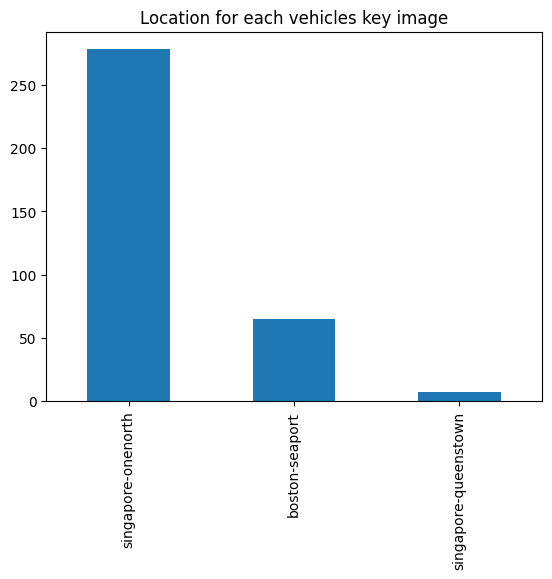

In [5]:
log_df['location'].value_counts().plot(kind='bar')
plt.title('Location for each vehicles key image')

In this project , we only want to train on the images in Singapore. So the sample taken in boston will be filtered out.

In [96]:
log_df1 = log_df[log_df['location'].str.contains(r'singapore')] # select only the images from Singapore

In [97]:
print(log_df1.shape)
print(log_df1.value_counts('location')) # check the number of images from each location

(285, 5)
location
singapore-onenorth      278
singapore-queenstown      7
dtype: int64


In [98]:
log_df1 = log_df1[['token','location']]  # select only the token and location columns
log_df1.head()

,token,location
0,ddefc6e23b5147a4bb04f51ebcb8ddb1,singapore-onenorth
1,8322bb4604ad409886bb655470941a22,singapore-onenorth
2,d0e0f3306cf6413e82fc4b9ea1f1f00a,singapore-onenorth
3,5928fde4e2254e4aa47e50424b8cfa6f,singapore-onenorth
4,59933f0443fb401c85292dc94de5d32e,singapore-onenorth


In [99]:
log_df1.rename(columns={'token':'logtoken'}, inplace=True) # rename the token column to logtoken, so that it can be merged with the token column in the annotation file
log_df1.head()

,logtoken,location
0,ddefc6e23b5147a4bb04f51ebcb8ddb1,singapore-onenorth
1,8322bb4604ad409886bb655470941a22,singapore-onenorth
2,d0e0f3306cf6413e82fc4b9ea1f1f00a,singapore-onenorth
3,5928fde4e2254e4aa47e50424b8cfa6f,singapore-onenorth
4,59933f0443fb401c85292dc94de5d32e,singapore-onenorth


### 2. Sample File Processing

In [100]:
## Sample file 
with open('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/v1.0-train/sample.json', 'rb') as f:
  sample = json.load(f)
  sample_df = pd.DataFrame(sample)

In [101]:
print(sample_df.shape)
sample_df.head()

(67279, 4)


,token,timestamp,log_token,key_camera_token
0,0000ad4e5f8440649a605e59b140bbe6,1514952516307486,ddefc6e23b5147a4bb04f51ebcb8ddb1,d7419240c6aa4cc9ae257b18e9b6087f
1,0001746b484f4a0f939ff8c8b836a7e4,1527709308919956,a16c68f6c9bd47efaec2d05206dd0637,7e19c8ab6b184b4baa82a0bb4340bdad
2,00022ed4280148638a327eb7f23f4836,1532919794370176,abffe4c2e8d6471283b2196684fafc62,04906b81e926432a9cfd3829383d6c01
3,000348f934a241ce98145feba50174d1,1531375280004844,31bb8149acc348d1868c70a9eedfe5b7,33b1e12f873242d58a18650de1f2a76a
4,0003ecb541c64fb9b30117044f8ee0cc,1530511879797243,8d81b47910d240c9b5faa318778034aa,b7cb521c4d03471c8fd486f42a5804fe


In [102]:
print(len(sample_df['log_token'].unique()))
sample_df = sample_df[['token','log_token','key_camera_token']]
sample_df.rename(columns={'token':'sampletoken'}, inplace=True)
sample_df.head()

350


,sampletoken,log_token,key_camera_token
0,0000ad4e5f8440649a605e59b140bbe6,ddefc6e23b5147a4bb04f51ebcb8ddb1,d7419240c6aa4cc9ae257b18e9b6087f
1,0001746b484f4a0f939ff8c8b836a7e4,a16c68f6c9bd47efaec2d05206dd0637,7e19c8ab6b184b4baa82a0bb4340bdad
2,00022ed4280148638a327eb7f23f4836,abffe4c2e8d6471283b2196684fafc62,04906b81e926432a9cfd3829383d6c01
3,000348f934a241ce98145feba50174d1,31bb8149acc348d1868c70a9eedfe5b7,33b1e12f873242d58a18650de1f2a76a
4,0003ecb541c64fb9b30117044f8ee0cc,8d81b47910d240c9b5faa318778034aa,b7cb521c4d03471c8fd486f42a5804fe


Confirmed that the unique samples in this file match with the number of samples in log file.

In [103]:
df1 = pd.merge(log_df1,sample_df,how='left',left_on='logtoken',right_on="log_token",sort=False) # merge the log and sample files

In [104]:
print(df1.shape)
df1 = df1[['logtoken','sampletoken','key_camera_token']]
df1.head()

(50786, 5)


,logtoken,sampletoken,key_camera_token
0,ddefc6e23b5147a4bb04f51ebcb8ddb1,0000ad4e5f8440649a605e59b140bbe6,d7419240c6aa4cc9ae257b18e9b6087f
1,ddefc6e23b5147a4bb04f51ebcb8ddb1,003dd8e0e592430eb79d73af5815a845,96be4eddf8744339a50f036f20de7852
2,ddefc6e23b5147a4bb04f51ebcb8ddb1,014e95ff3221473aa30ce151d13f3595,2ba180e884824c0aa3dc719571f95eab
3,ddefc6e23b5147a4bb04f51ebcb8ddb1,01f1d0c97cbd46b1bb25b0f036b32b7b,a9e23756713b4feab32de58998de44da
4,ddefc6e23b5147a4bb04f51ebcb8ddb1,0200f324ac3e43a28126159bbfeaf16c,5697b4e0d9f04d26aefbef2691bbe0a9


---

### 3. Sample_data file processing

In [107]:
## Sample_data file
with open('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/v1.0-train/sample_data.json', 'rb') as f:
    sample_data = json.load(f)
    sample_data_df = pd.DataFrame(sample_data)

In [108]:
print(sample_data_df.shape)
print(len(sample_data_df['sample_token'].unique()))
sample_data_df.head()

(872181, 12)
67279


,token,sample_token,ego_pose_token,calibrated_sensor_token,filename,fileformat,width,height,timestamp,is_key_frame,prev,next
0,000017500ce34486917d0466cbfbf52b,0b74713ca3724e828f94b75e2ef2e1e9,e68df340c0e6444b87568d2d7bf03ccc,6b8cc6f9ac875c858c8a9721d8b8216b,sweeps/CAM_BACK_LEFT/n008-2018-05-30-15-20-59-...,jpg,1600,900,1527708795797295,False,a249592ff3c8472b823e8414ece825e1,fc583c2d9bc94769b9a6e5f9a3c42cf4
1,000051686c3b48108a7d53d93316fa45,747ae7c3db0649fea848bbd47142f5b7,455c1154a3234893b8edd11e3ce4cc1b,b47fbaae10915cd5b78e93df169d25ac,sweeps/CAM_FRONT_RIGHT/n003-2018-07-12-15-40-3...,jpg,1600,900,1531381524170363,False,35ef3c670a0046be87855042350df241,270fd94a5274413faf1fed9188a4ff8f
2,00006f384c3f4a8f8a717df4682fca36,a5cbdb65b60a4429a8bcbff24fca04b3,650cab1832ac4837a5fef8032b4f42e8,72365a01bb545e24b07939d431a63eec,sweeps/CAM_FRONT/n003-2018-01-04-11-23-25+0800...,jpg,1600,900,1515036569455739,False,e4232abc36e84b10873bec33bb56d386,96ff6898cc0f4764a79df90abac67663
3,0000722ca1284dc9a08e985df728e487,0b2a7ffe859c482b9bf00aa593920762,be61dd9aaa644e38ba3e066b6017a43e,5fae4d74d39950a7bddc0cbab331ce48,sweeps/CAM_BACK/n008-2018-05-21-11-06-59-0400_...,jpg,1600,900,1526915806887570,False,,f32c05dca3c14ee8988aadc2047eb004
4,0000a1d9f58149fe90ab16b2ec0719fb,f557bb69871646db99d59c14adc9b625,c3bad51328794109963b851914f47d95,4b4363e0c7665e1aa0bb55eef1e91cdd,sweeps/CAM_FRONT/n016-2018-07-11-15-11-46+0800...,jpg,1600,900,1531293930612515,False,c89603741ec74c87ae30d7b254708239,5cfaaae367ac4978b16c14b9c686c701


In [110]:
sample_data_df = sample_data_df[['token','sample_token','filename','width','height','is_key_frame']] # select only the required columns
sample_data_df.rename(columns={'token':'sample_datatoken'}, inplace=True) # rename the token column to sample_datatoken, so that it can be merged with the token column in the annotation file
sample_data_df.head()

,sample_datatoken,sample_token,filename,width,height,is_key_frame
0,000017500ce34486917d0466cbfbf52b,0b74713ca3724e828f94b75e2ef2e1e9,sweeps/CAM_BACK_LEFT/n008-2018-05-30-15-20-59-...,1600,900,False
1,000051686c3b48108a7d53d93316fa45,747ae7c3db0649fea848bbd47142f5b7,sweeps/CAM_FRONT_RIGHT/n003-2018-07-12-15-40-3...,1600,900,False
2,00006f384c3f4a8f8a717df4682fca36,a5cbdb65b60a4429a8bcbff24fca04b3,sweeps/CAM_FRONT/n003-2018-01-04-11-23-25+0800...,1600,900,False
3,0000722ca1284dc9a08e985df728e487,0b2a7ffe859c482b9bf00aa593920762,sweeps/CAM_BACK/n008-2018-05-21-11-06-59-0400_...,1600,900,False
4,0000a1d9f58149fe90ab16b2ec0719fb,f557bb69871646db99d59c14adc9b625,sweeps/CAM_FRONT/n016-2018-07-11-15-11-46+0800...,1600,900,False


In [111]:
print(sample_data_df['is_key_frame'].value_counts())
sample_data_df.info()

False    804902
True      67279
Name: is_key_frame, dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 872181 entries, 0 to 872180
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   sample_datatoken  872181 non-null  object
 1   sample_token      872181 non-null  object
 2   filename          872181 non-null  object
 3   width             872181 non-null  int64 
 4   height            872181 non-null  int64 
 5   is_key_frame      872181 non-null  bool  
dtypes: bool(1), int64(2), object(3)
memory usage: 34.1+ MB


It can be observed here the is_key_frame = True for  `sample_data` file is 67279 rows, which is equal to the original length of unique `sample` file. 
To down scale the data for this project, only key_frame image will be used in this project.

In [112]:
## create file_name column
sample_data_df['file_name'] = sample_data_df['filename'].apply(lambda x: re.sub(r'.*/','',x)) # extract the file name from the filename column

In [113]:
sample_data_df = sample_data_df[sample_data_df['is_key_frame']==True] # select only the key frames
sample_data_df.head()

,sample_datatoken,sample_token,filename,width,height,is_key_frame,file_name
14,0001c184bea6429b8372f7ea88e4fe1c,3e2a3a525f4d4aefab26a1de358abb91,samples/CAM_FRONT_LEFT/n013-2018-08-29-14-19-1...,1600,900,True,n013-2018-08-29-14-19-16+0800__CAM_FRONT_LEFT_...
16,0001d9cf1d0f488f83efca4cbc87edbf,6c3b00dc4c98417ca13db0a438fde296,samples/CAM_BACK_RIGHT/n004-2018-01-03-16-11-2...,1600,900,True,n004-2018-01-03-16-11-21+0800__CAM_BACK_RIGHT_...
20,0002098114084658ab64a18cc6d92f57,5ec8e198492e40a4982fe7dea6b70680,samples/CAM_BACK_LEFT/n010-2018-07-03-11-30-01...,1600,900,True,n010-2018-07-03-11-30-01+0800__CAM_BACK_LEFT__...
29,00027ea3221446a5b38cc05d76bde07f,d3ad9dc2dc594e9db885b89bfbc184f3,samples/CAM_FRONT_LEFT/n003-2018-01-05-16-07-1...,1600,900,True,n003-2018-01-05-16-07-19+0800__CAM_FRONT_LEFT_...
39,00032468f7d04a26b17c46621b00752c,0b4abed575c0446d9db5b92845da677e,samples/CAM_BACK_RIGHT/n013-2018-07-31-11-08-2...,1600,900,True,n013-2018-07-31-11-08-29+0800__CAM_BACK_RIGHT_...


In [114]:
## merge sample_data_df with df1

df2 = pd.merge(df1,sample_data_df,how='left',left_on='sampletoken',right_on="sample_token",sort=False)
df2.head()

,logtoken,sampletoken,key_camera_token,sample_datatoken,sample_token,filename,width,height,is_key_frame,file_name
0,ddefc6e23b5147a4bb04f51ebcb8ddb1,0000ad4e5f8440649a605e59b140bbe6,d7419240c6aa4cc9ae257b18e9b6087f,d7419240c6aa4cc9ae257b18e9b6087f,0000ad4e5f8440649a605e59b140bbe6,samples/CAM_BACK_RIGHT/n003-2018-01-03-12-03-2...,1600,900,True,n003-2018-01-03-12-03-23+0800__CAM_BACK_RIGHT_...
1,ddefc6e23b5147a4bb04f51ebcb8ddb1,003dd8e0e592430eb79d73af5815a845,96be4eddf8744339a50f036f20de7852,96be4eddf8744339a50f036f20de7852,003dd8e0e592430eb79d73af5815a845,samples/CAM_BACK/n003-2018-01-03-12-03-23+0800...,1600,900,True,n003-2018-01-03-12-03-23+0800__CAM_BACK__15149...
2,ddefc6e23b5147a4bb04f51ebcb8ddb1,014e95ff3221473aa30ce151d13f3595,2ba180e884824c0aa3dc719571f95eab,2ba180e884824c0aa3dc719571f95eab,014e95ff3221473aa30ce151d13f3595,samples/CAM_BACK_RIGHT/n003-2018-01-03-12-03-2...,1600,900,True,n003-2018-01-03-12-03-23+0800__CAM_BACK_RIGHT_...
3,ddefc6e23b5147a4bb04f51ebcb8ddb1,01f1d0c97cbd46b1bb25b0f036b32b7b,a9e23756713b4feab32de58998de44da,a9e23756713b4feab32de58998de44da,01f1d0c97cbd46b1bb25b0f036b32b7b,samples/CAM_BACK/n003-2018-01-03-12-03-23+0800...,1600,900,True,n003-2018-01-03-12-03-23+0800__CAM_BACK__15149...
4,ddefc6e23b5147a4bb04f51ebcb8ddb1,0200f324ac3e43a28126159bbfeaf16c,5697b4e0d9f04d26aefbef2691bbe0a9,5697b4e0d9f04d26aefbef2691bbe0a9,0200f324ac3e43a28126159bbfeaf16c,samples/CAM_FRONT_RIGHT/n003-2018-01-03-12-03-...,1600,900,True,n003-2018-01-03-12-03-23+0800__CAM_FRONT_RIGHT...


In [115]:
print(len(df2['sampletoken'].unique()))
print(df2['is_key_frame'].value_counts())

50786
True    50786
Name: is_key_frame, dtype: int64


The sample of unique sample data token numbers match with ***df1***, which is 50786 rows. (only for key frame)

In [116]:
## Filter the useful columns in df2 

df2 = df2[['sample_datatoken','file_name','width','height','filename']]
df2.head(3)

,sample_datatoken,file_name,width,height,filename
0,d7419240c6aa4cc9ae257b18e9b6087f,n003-2018-01-03-12-03-23+0800__CAM_BACK_RIGHT_...,1600,900,samples/CAM_BACK_RIGHT/n003-2018-01-03-12-03-2...
1,96be4eddf8744339a50f036f20de7852,n003-2018-01-03-12-03-23+0800__CAM_BACK__15149...,1600,900,samples/CAM_BACK/n003-2018-01-03-12-03-23+0800...
2,2ba180e884824c0aa3dc719571f95eab,n003-2018-01-03-12-03-23+0800__CAM_BACK_RIGHT_...,1600,900,samples/CAM_BACK_RIGHT/n003-2018-01-03-12-03-2...


In [117]:
print(df2.shape)

(50786, 5)


## Down scale data with consideration of project period and hardware limitation in training the images
 
At this point, let's decide only **10 %** of overall data to be used in ML model training and validation, 50k images is too much for this project timeline.

In [118]:
df3 = df2.sample(frac=0.1, replace=False, random_state=42)
print(df3.shape)

(5079, 5)


In [119]:
print(df3['sample_datatoken'].nunique())
df3.head()

5079


,sample_datatoken,file_name,width,height,filename
30299,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...
42873,e81555201a7f4095a4a5bcc0fb7c7adf,n015-2018-09-05-11-47-58+0800__CAM_BACK__15361...,1600,900,samples/CAM_BACK/n015-2018-09-05-11-47-58+0800...
22926,e79303b77f834c7ebf1cbb1c9ef83242,n013-2018-08-03-14-44-49+0800__CAM_BACK_RIGHT_...,1600,900,samples/CAM_BACK_RIGHT/n013-2018-08-03-14-44-4...
17557,2f9ff66dff7f4632b53a487b4d190f39,n013-2018-07-31-10-55-31+0800__CAM_BACK__15330...,1600,900,samples/CAM_BACK/n013-2018-07-31-10-55-31+0800...
42097,a0fac8dd7ec0498c80e06e2d6e63abb5,n015-2018-07-13-10-42-25+0800__CAM_FRONT__1531...,1600,900,samples/CAM_FRONT/n015-2018-07-13-10-42-25+080...


Only 5079 images choosen for further feature processing.

---

### 4. Surface Annotation File

In [120]:
## Surface Annotation file

with open('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/v1.0-train/surface_ann.json', 'rb') as f:
    surface_anns = json.load(f)
    surface_anns_df = pd.DataFrame(surface_anns)

In [121]:
print(surface_anns_df.shape)
surface_anns_df.head()

(73755, 4)


,token,category_token,mask,sample_data_token
0,000031cadea55bd8b845efe3ffeb273d,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'U1hkajAxU2wwM...",13724e1163cd4d39829b45d21bceebdf
1,0002160842bc5ba9b9be100615f18806,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'VGUwVzRtZzAwT...",bbd5731d00d54a0da410cdfd54de58c9
2,0002183d61445043a4ad5ed83afe9cb0,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'WF4yUzZRZjAwM...",2d7d3e4f63674dc2acfef26c1c1bedfa
3,000367cb36b35af08f1a031c9f78ba49,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'a2kwWTJhZzBaM...",eba58edcd4f04fc69902687d2672c12a
4,0005bfed422758dc9dba02d7c02ecd76,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'VWkwbzJVYzBQN...",d948f4503cdb45fe9e008c2a11b72a1c


In [122]:
surface_anns_df.rename(columns={'token':'surface_annstoken'}, inplace=True) # rename the token column to surface_annstoken, so that it can be merged with the token column in the annotation file

In [123]:
## merge surface_anns_df with df3

df4 = pd.merge(df3,surface_anns_df,how='left',left_on='sample_datatoken',right_on="sample_data_token",sort=False)
print(df4.shape)
df4.head()

(5917, 9)


,sample_datatoken,file_name,width,height,filename,surface_annstoken,category_token,mask,sample_data_token
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,ef217ad714085b9f8cfc2ff1f2b65729,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'ZWkwWDFsajBXM...",8ea749c4295945a0a2b3a0fefa28164b
1,e81555201a7f4095a4a5bcc0fb7c7adf,n015-2018-09-05-11-47-58+0800__CAM_BACK__15361...,1600,900,samples/CAM_BACK/n015-2018-09-05-11-47-58+0800...,b07a45a8b5295ea09407a4b7e7bf2841,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'V2IxZzNlZDBoM...",e81555201a7f4095a4a5bcc0fb7c7adf
2,e81555201a7f4095a4a5bcc0fb7c7adf,n015-2018-09-05-11-47-58+0800__CAM_BACK__15361...,1600,900,samples/CAM_BACK/n015-2018-09-05-11-47-58+0800...,cc8ce437dca05b4c95117b80ad8bb87b,7754874e6d0247f9855ae19a4028bf0e,"{'size': [900, 1600], 'counts': 'Y2swYTBfajBUM...",e81555201a7f4095a4a5bcc0fb7c7adf
3,e79303b77f834c7ebf1cbb1c9ef83242,n013-2018-08-03-14-44-49+0800__CAM_BACK_RIGHT_...,1600,900,samples/CAM_BACK_RIGHT/n013-2018-08-03-14-44-4...,3bc8940a7b145e258f20d6a90de563fb,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'VGowUDJSaDBSM...",e79303b77f834c7ebf1cbb1c9ef83242
4,2f9ff66dff7f4632b53a487b4d190f39,n013-2018-07-31-10-55-31+0800__CAM_BACK__15330...,1600,900,samples/CAM_BACK/n013-2018-07-31-10-55-31+0800...,05e36fc225525079a2d861fcc80367eb,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'YWMwYDJkaTBfM...",2f9ff66dff7f4632b53a487b4d190f39


In [124]:
df4 = df4[['sample_datatoken','file_name','width','height','filename','surface_annstoken','category_token','mask']] # select only the required columns
df4.dropna(inplace=True) # drop the rows with null values - which means there is no surface annotation for that image
print(df4.shape)
print(len(df4['sample_datatoken'].unique()))

(5534, 8)
4696


This result shows that only `4696 image` in our dataset has road surface annotation.

---
Next , **decode the mask** and create a bounding box column for surface object in order to match with `COCO` annotation dataset format.

In [125]:
# The decode tool from nuimages will be used
# Then create a polygon mask for each surface annotation
from nuimages.utils.utils import mask_decode
from skimage import measure


def decode_mask(mask): # function to decode the mask and return as polygon
    mask = mask_decode(mask)
    mask_list = np.ascontiguousarray(mask, dtype=np.uint8)
    contours = measure.find_contours(mask_list, 0.5)
    annotation = []
    for contour in contours:
        contour = np.flip(contour, axis=1)
        segmentation = contour.ravel().tolist()
        annotation.append(segmentation)
    return annotation


In [126]:
df4['Mask'] = df4['mask'].apply(lambda x: decode_mask(x)) # apply the decode_mask function to the mask column

In [127]:
# check the purity of the mask
df4['Mask'].apply(lambda x: len(x)).value_counts().sort_index()

1      1740
2       779
3       483
4       358
5       353
       ... 
110       1
112       1
118       1
120       1
165       1
Name: Mask, Length: 80, dtype: int64

There are more than one surface mask in most of the images. But since COCO annotation format only has one segmentation per category, so we only can has one surface annotation per row and create a bboxx around that mask. The seperated mask rows are then processed to create individual bbox as its annotation.

In [128]:
## One image might have more than 1 surface, so we need to split the dataframe in rows
df4 = df4.explode('Mask')

In [129]:
df4.head()

,sample_datatoken,file_name,width,height,filename,surface_annstoken,category_token,mask,Mask
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,ef217ad714085b9f8cfc2ff1f2b65729,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'ZWkwWDFsajBXM...","[458.0, 539.5, 457.0, 539.5, 456.0, 539.5, 455..."
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,ef217ad714085b9f8cfc2ff1f2b65729,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'ZWkwWDFsajBXM...","[0.0, 820.5, 1.0, 820.5, 1.5, 820.0, 2.0, 819...."
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,ef217ad714085b9f8cfc2ff1f2b65729,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'ZWkwWDFsajBXM...","[711.0, 532.5, 710.0, 532.5, 709.0, 532.5, 708..."
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,ef217ad714085b9f8cfc2ff1f2b65729,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'ZWkwWDFsajBXM...","[1573.0, 575.5, 1572.0, 575.5, 1571.0, 575.5, ..."
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,ef217ad714085b9f8cfc2ff1f2b65729,a86329ee68a0411fb426dcad3b21452f,"{'size': [900, 1600], 'counts': 'ZWkwWDFsajBXM...","[1599.0, 578.5, 1598.0, 578.5, 1597.5, 578.0, ..."


In [130]:
df4['Mask'].apply(lambda x: len(x)).value_counts().sort_index()[0:50]

C:\Users\pkfei\AppData\Local\Temp\ipykernel_25916\2762265855.py:1: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  df4['Mask'].apply(lambda x: len(x)).value_counts().sort_index()[0:50]


4        4
6        4
8        3
10     320
12       1
14      79
16       1
18      85
20       1
22      39
26      52
28       2
30      30
34      27
36       3
38      22
40       1
42      66
44       3
46      68
48       4
50     108
52       4
54     164
56       3
58     186
60       4
62     216
64       4
66     263
68       1
70     293
72       8
74     300
76       4
78     291
80       5
82     296
84       4
86     309
88      14
90     330
92      12
94     310
96      11
98     339
100      1
102    324
104     15
106    328
Name: Mask, dtype: int64

In [131]:
# check the total number of surface annotations mask in the dataframe
print(df4.shape)
print(len(df4['sample_datatoken'].unique()))

(32747, 9)
4696


With only 4696 image in the dataset, but there are total 32747 surface masks!

In [132]:
df4['TrueMask'] = df4['Mask'] # create a new column TrueMask and copy the Mask column

In [133]:
# creating bounding box for each surface annotation

def get_bbox(mask):
    x = np.array(mask[::2])
    y = np.array(mask[1::2])
    return [min(x), min(y), max(x), max(y)]

In [134]:
# function to calculate the size of the bounding box

def get_area(bbox):
    return (bbox[2]-bbox[0])*(bbox[3]-bbox[1])

In [135]:
df4['bbox'] = df4['TrueMask'].apply(lambda x: get_bbox(x)) # apply the get_bbox function to the TrueMask column

In [137]:
# Filter out the surface annotations with polygon point less than 8 (coordinate with 6 points and below are not considered as polygon)

df4 = df4[(df4['TrueMask'].apply(lambda x: len(x)) > 8)]

In [138]:
df4['area'] = df4['bbox'].apply(lambda x: get_area(x)) # apply the get_area function to the bbox column

<AxesSubplot: ylabel='Frequency'>

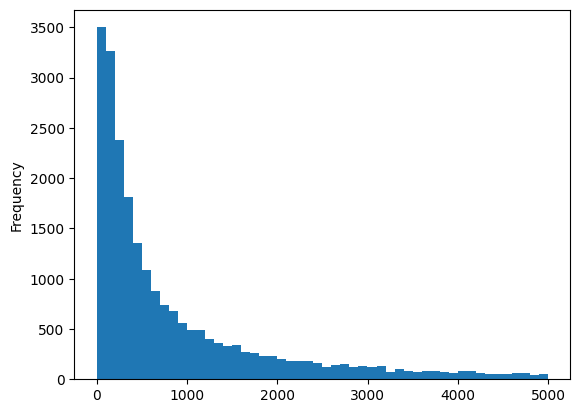

In [140]:
df4[df4['area']<5000]['area'].plot(kind='hist', bins=50) # plot the histogram of the area column

From the plot, it shows that there are many small surface masks that generated from the decode function, which will be filter out to reduce noise and save time in training the data

In [143]:
df4 = df4[df4['area']>3000]
print(df4.shape)

(11521, 12)


Only **11521** surface annotations are left after filtering out the surface annotations with polygon point less than 8 and area less than 3000.

In [144]:
df4.drop(columns=['Mask','mask','surface_annstoken','area'], inplace=True) # drop the columns that are not required

### 5.  Object_annotation file processing

In [145]:
## Object Annotation file

with open('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/v1.0-train/object_ann.json', 'rb') as f:
    obj_anns = json.load(f)
    obj_anns_df = pd.DataFrame(obj_anns)

In [146]:
print(obj_anns_df.shape)
obj_anns_df.head()

(557715, 6)


,token,category_token,bbox,mask,attribute_tokens,sample_data_token
0,000015922354462eac2578a612e00b31,653f7efbb9514ce7b81d44070d6208c1,"[1167, 473, 1263, 530]","{'size': [900, 1600], 'counts': 'Z1RSUDE3bmswN...",[],885437043b694431aa939ec73cd24f30
1,000029fa14674ac19505b94a4839194f,85abebdccd4d46c7be428af5a6173947,"[946, 558, 981, 657]","{'size': [900, 1600], 'counts': 'ZlJQajAyUGwwM...",[],62c5e1f806ed42d3aca34bb09d72c48f
2,0000427902a34f1fa68fbfaf44e0ac47,fc95c87b806f48f8a1faea2dcc2222a4,"[558, 419, 595, 450]","{'size': [900, 1600], 'counts': 'aWNcPzRsazA2T...",[725f0121878f4c86909f256fd9df8569],a971e6707a2149879db5208466991455
3,00004dd38b934690965746970fc39e1f,fd69059b62a3469fbaef25340c0eab7f,"[515, 425, 629, 467]","{'size': [900, 1600], 'counts': 'blFSPzFTbDAwM...",[9f65c1eaa74e4d5db46e87a34811e994],6f458d474f824067a850187b5ebb5f0c
4,000055039e8d485ab115957af53fcb0e,fd69059b62a3469fbaef25340c0eab7f,"[1477, 453, 1600, 565]",None,[abc0f113547848a9baaa62096fca37f5],f3c768c9644f4f87a4f433bd7a4c0b30


In [147]:
obj_anns_df.rename(columns={'token':'obj_annstoken'}, inplace=True) # rename the token column to obj_annstoken, so that it can be merged with the token column in the annotation file

In [148]:
## merge obj_anns_df with df3

df5 = pd.merge(df3,obj_anns_df,how='left',left_on='sample_datatoken',right_on="sample_data_token",sort=False)
print(df5.shape)
df5.head()

(37556, 11)


,sample_datatoken,file_name,width,height,filename,obj_annstoken,category_token,bbox,mask,attribute_tokens,sample_data_token
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,08a3f6a6fd8046e59e12525b5c7e0d2d,653f7efbb9514ce7b81d44070d6208c1,"[378, 471, 418, 498]","{'size': [900, 1600], 'counts': 'XF5eOjUyTWRrM...",[],8ea749c4295945a0a2b3a0fefa28164b
1,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,2bd4bf2b65a143cba626179f3c149b38,653f7efbb9514ce7b81d44070d6208c1,"[973, 503, 1027, 528]","{'size': [900, 1600], 'counts': 'b2VnajAzUWwwM...",[],8ea749c4295945a0a2b3a0fefa28164b
2,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,2defc06e51c34ccfbd33083a318140a1,fd69059b62a3469fbaef25340c0eab7f,"[279, 471, 401, 507]","{'size': [900, 1600], 'counts': 'VV5hOTFUbDAxT...",[abc0f113547848a9baaa62096fca37f5],8ea749c4295945a0a2b3a0fefa28164b
3,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,2efc530457954e81b8b133513440fb5e,653f7efbb9514ce7b81d44070d6208c1,"[1021, 505, 1034, 528]","{'size': [900, 1600], 'counts': 'aF9UbDBjMGFrM...",[],8ea749c4295945a0a2b3a0fefa28164b
4,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,3a38636a4f16419aa5bc6d392b377b42,85abebdccd4d46c7be428af5a6173947,"[1144, 651, 1230, 790]","{'size': [900, 1600], 'counts': 'V1NfbzA0UGwwM...",[],8ea749c4295945a0a2b3a0fefa28164b


In [149]:
df5.dropna(inplace=True)
print(len(df5['sample_datatoken'].unique())) # check the number of unique sample_datatoken in the dataframe

4506


There is 4506 images with 37556 objects in this dataset.

In [150]:
df5.isnull().sum()

sample_datatoken     0
file_name            0
width                0
height               0
filename             0
obj_annstoken        0
category_token       0
bbox                 0
mask                 0
attribute_tokens     0
sample_data_token    0
dtype: int64

In [151]:
df5['Mask'] = df5['mask'].apply(lambda x: decode_mask(x)) # apply the decode_mask function to the mask column

In [152]:
# check the purity of the mask
df5['Mask'].apply(lambda x: len(x)).value_counts().sort_index()

0         1
1     26858
2      5855
3      2014
4       913
5       432
6       242
7       133
8        94
9        64
10       48
11       36
12       22
13       28
14       18
15       12
16        8
17        7
18       11
19        8
20        4
21        6
22        3
23        6
24        6
25        3
26        3
27        2
28        3
29        1
32        3
33        2
45        1
52        2
53        1
58        1
61        1
64        1
Name: Mask, dtype: int64

Since this object annotation dataset is for individual object located in the image. The number of object that not equal to 1 might due to the discrepancy of the masking and demask algorithm by `NUImage` and `skimage`. Hence, we will use the data with only 1 onject mask to eliminate the noise in the dataset.

In [153]:
df5['Maskcount'] = df5['Mask'].apply(lambda x: len(x))
df5 = df5[df5['Maskcount']==1] # filter out the rows with more than 1 mask

In [154]:
df5['TrueMask'] = df5['Mask'].apply(lambda x: x[0]) # create a new column TrueMask and copy the Mask column

In [156]:
df5 = df5[['sample_datatoken','file_name','width','height','filename','category_token','TrueMask','bbox']] # select only the required columns
print(df5.shape)
df5.head()

(26858, 8)


,sample_datatoken,file_name,width,height,filename,category_token,TrueMask,bbox
1,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,653f7efbb9514ce7b81d44070d6208c1,"[1020.0, 528.5, 1019.0, 528.5, 1018.5, 528.0, ...","[973, 503, 1027, 528]"
3,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,653f7efbb9514ce7b81d44070d6208c1,"[1024.0, 522.5, 1023.5, 522.0, 1023.5, 521.0, ...","[1021, 505, 1034, 528]"
4,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,85abebdccd4d46c7be428af5a6173947,"[1228.0, 789.5, 1227.0, 789.5, 1226.0, 789.5, ...","[1144, 651, 1230, 790]"
6,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,85abebdccd4d46c7be428af5a6173947,"[1032.0, 527.5, 1031.0, 527.5, 1030.0, 527.5, ...","[1023, 511, 1033, 530]"
8,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,fd69059b62a3469fbaef25340c0eab7f,"[1062.0, 527.5, 1061.5, 527.0, 1061.0, 526.5, ...","[1031, 496, 1075, 528]"


In [157]:
## Combine annotaion files and object annotation file

df6 = pd.concat([df4,df5],axis=0)
print(df6.shape)
df6.head()

(38379, 8)


,sample_datatoken,file_name,width,height,filename,category_token,TrueMask,bbox
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[458.0, 539.5, 457.0, 539.5, 456.0, 539.5, 455...","[368.5, 506.5, 459.5, 539.5]"
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[0.0, 820.5, 1.0, 820.5, 1.5, 820.0, 2.0, 819....","[0.0, 509.5, 1549.5, 899.0]"
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[711.0, 532.5, 710.0, 532.5, 709.0, 532.5, 708...","[565.5, 512.5, 729.5, 532.5]"
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[1382.5, 873.0, 1382.0, 872.5, 1381.5, 872.0, ...","[1147.5, 563.5, 1384.5, 873.5]"
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[1482.0, 719.5, 1481.0, 719.5, 1480.0, 719.5, ...","[1426.5, 586.5, 1482.5, 719.5]"


---

### 6. Category file processing 

In [158]:
## Combine with category file

with open('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/v1.0-train/category.json', 'rb') as f:
    category = json.load(f)
    category_df = pd.DataFrame(category)

In [159]:
category_df.head()

,token,name,description
0,63a94dfa99bb47529567cd90d3b58384,animal,"All animals, e.g. cats, rats, dogs, deer, birds."
1,a86329ee68a0411fb426dcad3b21452f,flat.driveable_surface,Surfaces should be regarded with no concern of...
2,1fa93b757fc74fb197cdd60001ad8abf,human.pedestrian.adult,Adult subcategory.
3,b1c6de4c57f14a5383d9f963fbdcb5cb,human.pedestrian.child,Child subcategory.
4,909f1237d34a49d6bdd27c2fe4581d79,human.pedestrian.construction_worker,Construction worker


In [160]:
# merge category_df with df6

df7 = pd.merge(df6,category_df[['token','name']],how='left',left_on='category_token',right_on="token",sort=False) # merge category_df with df6
print(df7.shape)
df7.head()

(38379, 10)


,sample_datatoken,file_name,width,height,filename,category_token,TrueMask,bbox,token,name
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[458.0, 539.5, 457.0, 539.5, 456.0, 539.5, 455...","[368.5, 506.5, 459.5, 539.5]",a86329ee68a0411fb426dcad3b21452f,flat.driveable_surface
1,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[0.0, 820.5, 1.0, 820.5, 1.5, 820.0, 2.0, 819....","[0.0, 509.5, 1549.5, 899.0]",a86329ee68a0411fb426dcad3b21452f,flat.driveable_surface
2,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[711.0, 532.5, 710.0, 532.5, 709.0, 532.5, 708...","[565.5, 512.5, 729.5, 532.5]",a86329ee68a0411fb426dcad3b21452f,flat.driveable_surface
3,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[1382.5, 873.0, 1382.0, 872.5, 1381.5, 872.0, ...","[1147.5, 563.5, 1384.5, 873.5]",a86329ee68a0411fb426dcad3b21452f,flat.driveable_surface
4,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,a86329ee68a0411fb426dcad3b21452f,"[1482.0, 719.5, 1481.0, 719.5, 1480.0, 719.5, ...","[1426.5, 586.5, 1482.5, 719.5]",a86329ee68a0411fb426dcad3b21452f,flat.driveable_surface


In [161]:
## Finalize the dataset in COCO format

df7.drop(columns=['category_token','token'], inplace=True)
df7.head(2)

,sample_datatoken,file_name,width,height,filename,TrueMask,bbox,name
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,"[458.0, 539.5, 457.0, 539.5, 456.0, 539.5, 455...","[368.5, 506.5, 459.5, 539.5]",flat.driveable_surface
1,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,"[0.0, 820.5, 1.0, 820.5, 1.5, 820.0, 2.0, 819....","[0.0, 509.5, 1549.5, 899.0]",flat.driveable_surface


In [162]:
## Explore the categories

df7['name'].value_counts()

flat.driveable_surface                  10651
vehicle.car                              7695
human.pedestrian.adult                   7152
movable_object.barrier                   4150
movable_object.trafficcone               3566
vehicle.truck                             999
vehicle.ego                               870
vehicle.motorcycle                        813
human.pedestrian.construction_worker      748
vehicle.bicycle                           612
vehicle.bus.rigid                         287
vehicle.construction                      189
movable_object.pushable_pullable          182
movable_object.debris                     122
human.pedestrian.personal_mobility        121
human.pedestrian.child                    120
static_object.bicycle_rack                 50
human.pedestrian.police_officer            19
vehicle.trailer                            12
animal                                      9
human.pedestrian.stroller                   7
vehicle.emergency.ambulance       

In [163]:
df7 = df7[df7['name']!='vehicle.ego'] # filter out the rows with category vehicle.ego as it is not required in this project

<AxesSubplot: >

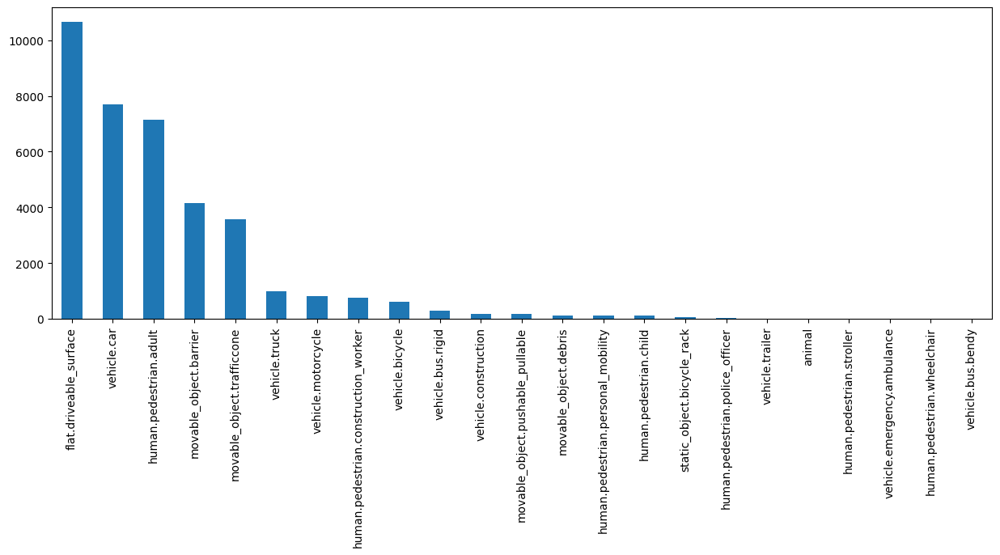

In [164]:
plt.figure(figsize=(15,5))
df7['name'].value_counts().plot(kind='bar')
plt.title('Number of annotations per category')

The top few classess seems to be dominant in their sample numbers, so we only select the top 8 classess in this project. 
This helps to reduce the issue caused by highly unbalance dataset and make sure enough annotations to be trained in the model.

If there is enough resources in the future, more data can be used and all the categories can be included to have a complete road object detection model.

In [165]:
classes = df7['name'].value_counts()[0:8].index.tolist() # select the top 8 categories
df7['category'] = df7['name'].apply(lambda x: x if x in classes else 0)

In [166]:
df8 = df7[df7['category']!=0] # filter out the rows with category 0
df8.drop(columns=['category'], inplace=True)
print(df8.shape)
df8.head(2)

(35774, 8)


C:\Users\pkfei\AppData\Local\Temp\ipykernel_25916\3105152244.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df8.drop(columns=['category'], inplace=True)


,sample_datatoken,file_name,width,height,filename,TrueMask,bbox,name
0,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,"[458.0, 539.5, 457.0, 539.5, 456.0, 539.5, 455...","[368.5, 506.5, 459.5, 539.5]",flat.driveable_surface
1,8ea749c4295945a0a2b3a0fefa28164b,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,samples/CAM_FRONT/n013-2018-08-20-15-15-12+080...,"[0.0, 820.5, 1.0, 820.5, 1.5, 820.0, 2.0, 819....","[0.0, 509.5, 1549.5, 899.0]",flat.driveable_surface


In [167]:
df8['name'].value_counts()

flat.driveable_surface                  10651
vehicle.car                              7695
human.pedestrian.adult                   7152
movable_object.barrier                   4150
movable_object.trafficcone               3566
vehicle.truck                             999
vehicle.motorcycle                        813
human.pedestrian.construction_worker      748
Name: name, dtype: int64

#### The final dataset has 35774 rows with 8 unique classess

The dataset is slightly unbalance. 

---

### Try to visualize the data before put into training to ensure the data is structured correctly.

In [169]:
def render_image(idx=0, dataroot='C:/Users/pkfei/OneDrive/Desktop/Capstone/data',
                 render_scale: float = 1.0,
                 box_line_width: int = -1,
                 font_size: int = 5,
                 out_path: str = None):

    # Get the image and annotations.
    print(df8.iloc[idx]['filename'])
    im_path = osp.join(dataroot, df8.iloc[idx]['filename'])
    im = Image.open(im_path)
    im = im.convert('RGBA')
    draw = ImageDraw.Draw(im, 'RGBA')
    draw.rectangle(df8.iloc[idx]['bbox'], outline='blue')
    draw.polygon(df8.iloc[idx]['TrueMask'], outline='red')
    draw.text((df8.iloc[idx]['bbox'][0],df8.iloc[idx]['bbox'][1]), df8.iloc[idx]['name'], fill='green',font_size=font_size)

    (width,height) = im.size
    pix_to_inch = 100/render_scale
    figsize = (height/pix_to_inch, width/pix_to_inch)
    fig = plt.figure(figsize=figsize)
    plt.axis('off')
    plt.imshow(im)


samples/CAM_BACK/n013-2018-08-17-11-41-53+0800__CAM_BACK__1534477440137005.jpg


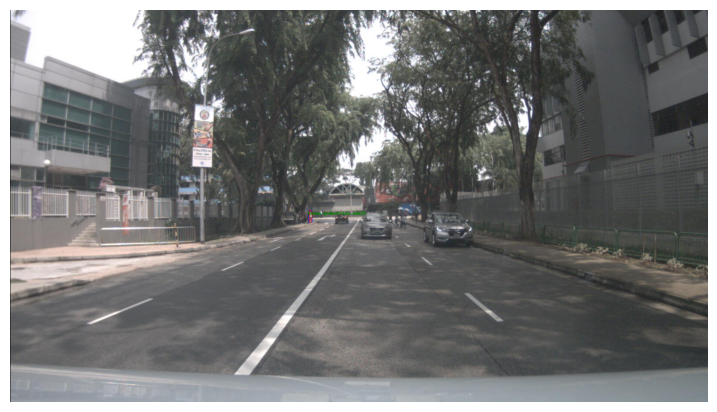

In [170]:
render_image(idx=21000)

samples/CAM_FRONT/n015-2018-09-05-10-54-58+0800__CAM_FRONT__1536116243612460.jpg


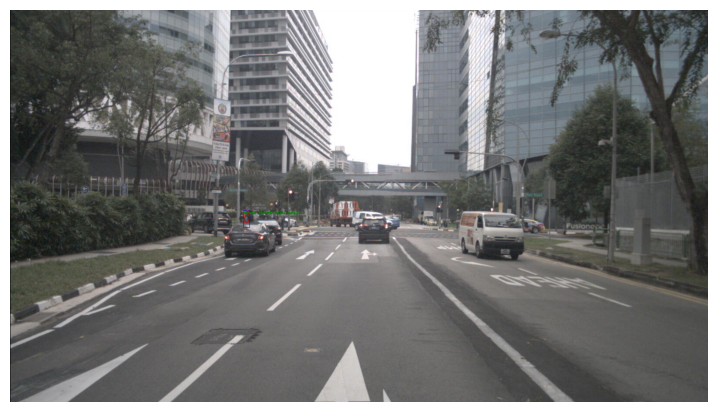

In [171]:
render_image(idx=13000)

In [172]:
## assign category ID

df8['category_id'] = df8['name'].apply(lambda x: classes.index(x)) # assign category ID for COCO dataset format

C:\Users\pkfei\AppData\Local\Temp\ipykernel_25916\2273147576.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df8['category_id'] = df8['name'].apply(lambda x: classes.index(x))


In [174]:
# we have 10 categories
df8['category_id'].value_counts(normalize=True)*100

0    29.773020
1    21.510035
2    19.992173
3    11.600604
4     9.968133
5     2.792531
6     2.272600
7     2.090904
Name: category_id, dtype: float64

The top category(driving surface) with around 30% of whole dataset but the last category (construction worker) only has 2% of the overall data. - **Data imbalance**.

In [175]:
##final dataset

df8 = df8[['file_name','width','height','category_id','TrueMask','bbox']] # select only the required columns
df8.head()

,file_name,width,height,category_id,TrueMask,bbox
0,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,0,"[458.0, 539.5, 457.0, 539.5, 456.0, 539.5, 455...","[368.5, 506.5, 459.5, 539.5]"
1,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,0,"[0.0, 820.5, 1.0, 820.5, 1.5, 820.0, 2.0, 819....","[0.0, 509.5, 1549.5, 899.0]"
2,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,0,"[711.0, 532.5, 710.0, 532.5, 709.0, 532.5, 708...","[565.5, 512.5, 729.5, 532.5]"
3,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,0,"[1382.5, 873.0, 1382.0, 872.5, 1381.5, 872.0, ...","[1147.5, 563.5, 1384.5, 873.5]"
4,n013-2018-08-20-15-15-12+0800__CAM_FRONT__1534...,1600,900,0,"[1482.0, 719.5, 1481.0, 719.5, 1480.0, 719.5, ...","[1426.5, 586.5, 1482.5, 719.5]"


In [176]:
df8['file_name'].unique().shape

(4801,)

In [177]:
df9 = df8.groupby('file_name').agg({'width':'first','height':'first','category_id':list,'TrueMask':list,'bbox':list}).reset_index()

In [178]:
print(df9.shape)
df9.head()

(4801, 6)


,file_name,width,height,category_id,TrueMask,bbox
0,n003-2018-01-03-12-03-23+0800__CAM_BACK_LEFT__...,1600,900,"[0, 0]","[[0.0, 626.5, 1.0, 626.5, 2.0, 626.5, 3.0, 626...","[[0.0, 456.5, 1599.0, 711.5], [0.0, 802.5, 159..."
1,n003-2018-01-03-12-03-23+0800__CAM_BACK_LEFT__...,1600,900,"[0, 2]","[[0.0, 752.5, 1.0, 752.5, 2.0, 752.5, 3.0, 752...","[[0.0, 752.5, 1477.5, 899.0], [1425, 461, 1529..."
2,n003-2018-01-03-12-03-23+0800__CAM_BACK_LEFT__...,1600,900,"[0, 0, 0, 0, 1, 2, 2, 2, 2, 2]","[[0.0, 500.5, 1.0, 500.5, 2.0, 500.5, 3.0, 500...","[[0.0, 487.5, 226.5, 561.5], [295.5, 510.5, 12..."
3,n003-2018-01-03-12-03-23+0800__CAM_BACK_LEFT__...,1600,900,"[0, 0]","[[0.0, 789.5, 1.0, 789.5, 2.0, 789.5, 3.0, 789...","[[0.0, 748.5, 780.5, 899.0], [216.5, 765.5, 33..."
4,n003-2018-01-03-12-03-23+0800__CAM_BACK_LEFT__...,1600,900,"[0, 1, 4]","[[0.0, 693.5, 1.0, 693.5, 2.0, 693.5, 3.0, 693...","[[0.0, 667.5, 1599.0, 726.5], [585, 453, 646, ..."


There are total 4801 unique images will be used in this project.

---

### Feature Engineering 
1. Train Test Split
2. Images filter and assignment into `train` and `val` folder.

In [180]:
## Training and validation set split

from sklearn.model_selection import train_test_split
import os
import shutil

In [181]:
X = df9
y = df9['file_name']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) # 80% training and 20% test, stratufy to ensure constant classess ratio

In [182]:
print(X_train.shape, X_test.shape)
X_train.reset_index(drop=True, inplace=True)
X_test.reset_index(drop=True, inplace=True)
X_train.head(2)

(3840, 6) (961, 6)


,file_name,width,height,category_id,TrueMask,bbox
0,n013-2018-08-20-15-15-12+0800__CAM_FRONT_LEFT_...,1600,900,"[0, 0]","[[1599.0, 692.5, 1598.0, 692.5, 1597.5, 692.0,...","[[1473.5, 517.5, 1599.0, 692.5], [1355.5, 534...."
1,n013-2018-08-27-14-41-26+0800__CAM_FRONT_LEFT_...,1600,900,[0],"[[584.5, 899.0, 585.0, 898.5, 586.0, 898.5, 58...","[[584.5, 691.5, 1599.0, 899.0]]"


In [198]:
## save the data into json annotation file

with open('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/train/json_annotation.json', 'wb') as f:
    X_train.to_json(f,orient='records')
with open('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/val/json_annotation.json', 'wb') as f:
    X_test.to_json(f,orient='records')

In [199]:
## Extract the images from the image folder and assign to train and test foler based on the json file
train_file = X_train['file_name'].tolist()
test_file = X_test['file_name'].tolist()

In [185]:
# assign directory

direct = ('train','val')

for d in direct:
    if not os.path.exists('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/'+d):
        os.makedirs('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/'+d)

    else:
        print('Directory already exists')
       
im_directory = "C:/Users/pkfei/OneDrive/Desktop/Capstone/data/samples"


Directory already exists
Directory already exists


In [200]:
# copy the files to the train and val folder

for dir in os.listdir(im_directory):
    #print(dir)
    im_directory1 = im_directory + "/" + dir

    for file in os.listdir(im_directory1):
        if file in train_file:
            if file not in os.listdir('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/train'):
               shutil.copyfile(im_directory1 + "/" + file, "C:/Users/pkfei/OneDrive/Desktop/Capstone/data/train/" + file)

        else:
            print(f'{file} file is not needed in training ')

        if file in test_file:
            if file not in os.listdir('C:/Users/pkfei/OneDrive/Desktop/Capstone/data/val'):
               shutil.copyfile(im_directory1 + "/" + file, "C:/Users/pkfei/OneDrive/Desktop/Capstone/data/val/" + file)
        else:
            print(f'{file} file is not needed in validation')

n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864956159109.jpg file is not needed in training 
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864956159109.jpg file is not needed in validation
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864966242882.jpg file is not needed in training 
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864966242882.jpg file is not needed in validation
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864976326585.jpg file is not needed in training 
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864976326585.jpg file is not needed in validation
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864986326996.jpg file is not needed in training 
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864986326996.jpg file is not needed in validation
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864996327399.jpg file is not needed in training 
n003-2018-01-02-11-48-43+0800__CAM_BACK__1514864996327399.jpg file is not needed in validation
n003-2018-01-02-11-48-43+0800__CAM_BACK__15148650064111

In [201]:
checkpath  = 'C:/Users/pkfei/OneDrive/Desktop/Capstone/data/train'
count = 0
for file in os.listdir(checkpath):
    if file not in train_file:
        print(file)
        #os.remove(checkpath + "/" + file)
    else:
        count += 1
print(f'{count} files in the train folder')    

print({len(X_train['file_name'].unique())}, 'files in the training set')

json_annotation.json
3840 files in the train folder
{3840} files in the training set


In [202]:
checkpath  = 'C:/Users/pkfei/OneDrive/Desktop/Capstone/data/val'
count = 0
for file in os.listdir(checkpath):
    if file not in test_file:
        print(file)
        #os.remove(checkpath + "/" + file)
    else:
        count += 1
print(f'{count} files in the val folder')    

print({len(X_test['file_name'].unique())}, 'files in the val set')

json_annotation.json
961 files in the val folder
{961} files in the val set


### After making sure the files are correctly assigned to the folders , the folders will be uploaded to dedicated google drive to be used in Colab for training for ML model.